# Part A – Importing and Understanding Data

In [2]:
# importthe library
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd
import numpy as np
import os

In [9]:
# explore the contents of our data directory
for root, dirs, files in os.walk("data"):
    for file in files:
        file_path = os.path.join(root, file)
        print(file_path)

data/sydney.geojson
data/zomato_df_final_data.csv


In [13]:
# import the data set 

# data set url 
csv_url = "data/zomato_df_final_data.csv"

# using pandas to read csv file as data frame 
df = pd.read_csv(csv_url, encoding = 'iso-8859-1')


# Exploring the data

In [14]:
# printing top 5 rows
df.head()

,address,cost,cuisine,lat,link,lng,phone,rating_number,rating_text,subzone,title,type,votes,groupon,color,cost_2,cuisine_color
0,"371A Pitt Street, CBD, Sydney",50.0,"['Hot Pot', 'Korean BBQ', 'BBQ', 'Korean']",-33.876059,https://www.zomato.com/sydney/sydney-madang-cbd,151.207605,02 8318 0406,4.0,Very Good,CBD,Sydney Madang,['Casual Dining'],1311.0,False,#e15307,5.243902,#6f706b
1,"Shop 7A, 2 Huntley Street, Alexandria, Sydney",80.0,"['Cafe', 'Coffee and Tea', 'Salad', 'PokÃ©']",-33.910999,https://www.zomato.com/sydney/the-grounds-of-a...,151.193793,02 9699 2225,4.6,Excellent,"The Grounds of Alexandria, Alexandria",The Grounds of Alexandria Cafe,['CafÃ©'],3236.0,False,#9c3203,7.560976,#6f706b
2,"Level G, The Darling at the Star, 80 Pyrmont ...",120.0,['Japanese'],-33.867971,https://www.zomato.com/sydney/sokyo-pyrmont,151.195210,1800 700 700,4.9,Excellent,"The Star, Pyrmont",Sokyo,['Fine Dining'],1227.0,False,#7f2704,10.650407,#6f706b
3,"Sydney Opera House, Bennelong Point, Circular...",270.0,['Modern Australian'],-33.856784,https://www.zomato.com/sydney/bennelong-restau...,151.215297,02 9240 8000,4.9,Excellent,Circular Quay,Bennelong Restaurant,"['Fine Dining', 'Bar']",278.0,False,#7f2704,22.235772,#4186f4
4,"20 Campbell Street, Chinatown, Sydney",55.0,"['Thai', 'Salad']",-33.879035,https://www.zomato.com/sydney/chat-thai-chinatown,151.206409,02 8317 4811,4.5,Excellent,Chinatown,Chat Thai,['Casual Dining'],2150.0,False,#a83703,5.630081,#6f706b


In [15]:
# get shape of the dataset
print(df.shape)

# information about dataset
print(df.info())

(10500, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10500 entries, 0 to 10499
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   address        10500 non-null  object 
 1   cost           10154 non-null  float64
 2   cuisine        10500 non-null  object 
 3   lat            10308 non-null  float64
 4   link           10500 non-null  object 
 5   lng            10308 non-null  float64
 6   phone          10500 non-null  object 
 7   rating_number  7184 non-null   float64
 8   rating_text    7184 non-null   object 
 9   subzone        10500 non-null  object 
 10  title          10500 non-null  object 
 11  type           10452 non-null  object 
 12  votes          7184 non-null   float64
 13  groupon        10500 non-null  bool   
 14  color          10500 non-null  object 
 15  cost_2         10154 non-null  float64
 16  cuisine_color  10500 non-null  object 
dtypes: bool(1), float64(6), object(10)
mem

Comment :
In `df.info()` helps to analyse the the type of data set including how complex is our exploring data . The data consists of 17 variable(columns) with 10500 different observations(row). From here we can see that there is 3 types of data (object, flaot and bool)

In [16]:
# statistical summary of dataset
print(df.describe())

               cost           lat           lng  rating_number        votes  \
count  10154.000000  10308.000000  10308.000000    7184.000000  7184.000000   
mean      51.153240    -32.921377    148.067359       3.283672    83.581013   
std       27.799485      8.263449     26.695402       0.454580   175.117966   
min        8.000000    -37.858473   -123.270371       1.800000     4.000000   
25%       30.000000    -33.899094    151.061061       3.000000    12.000000   
50%       45.000000    -33.872741    151.172468       3.300000    32.000000   
75%       60.000000    -33.813451    151.208940       3.600000    87.000000   
max      500.000000     51.500986    152.869052       4.900000  3236.000000   

             cost_2  
count  10154.000000  
mean       5.332974  
std        2.147115  
min        2.000000  
25%        3.699187  
50%        4.857724  
75%        6.016260  
max       40.000000  


Comment:
`describe()` function shows the basic statistical computations on dataset.

In [17]:
# checking missing values
print(df.isnull().sum())

address             0
cost              346
cuisine             0
lat               192
link                0
lng               192
phone               0
rating_number    3316
rating_text      3316
subzone             0
title               0
type               48
votes            3316
groupon             0
color               0
cost_2            346
cuisine_color       0
dtype: int64


Comment: `df.isnull().sum()` shows the count of null value that contains in the obervations. It helps us to analyse the dataset and prepare us to take further actions to mitimize this null value.

In [18]:
# drop duplicates
df.drop_duplicates(inplace = True)
print(df.shape)

(10499, 17)


Comment: Here the drop duplicates remove the one duplicate row and now there are 10499 totals rows in dataset.

In [31]:
import ast

# Using literal_eval to flatten the cuisine lists
flat_cuisine = [cuisine for cuisines in df['cuisine'] for cuisine in ast.literal_eval(cuisines)]

# Get the number of unique cuisine types
unique_cuisines_count = len(set(flat_cuisine))

print(f"Total unique cuisines: {unique_cuisines_count}")

# Get the unique cuisine types
unique_cuisines = list(set(flat_cuisine))

# Printing the list of unique cuisine types and their count
print("List of unique cuisine types:")
for cuisine in unique_cuisines:
    print(cuisine)


Total unique cuisines: 134
List of unique cuisine types:
Ethiopian
Fish and Chips
Satay
Portuguese
Turkish
Steak
Syrian
Bakery
Modern Australian
Salad
Spanish
Sandwich
Pakistani
Cafe
Mexican
Vietnamese
Pizza
Singaporean
Irish
BBQ
Tapas
Fusion
European
Bar Food
Greek
Pub Food
Tibetan
Frozen Yogurt
Diner
Middle Eastern
Argentine
Nepalese
Shanghai
Dumplings
Austrian
Swedish
Hot Pot
Sri Lankan
Brasserie
Moroccan
Pho
International
Meat Pie
PokÃ©
Korean
British
Yum Cha
Desserts
Seafood
Teriyaki
Japanese BBQ
Falafel
Australian
Malaysian
Eastern European
German
Soul Food
South African
Oriental
Continental
Hungarian
Crepes
Sichuan
Japanese
African
Scandinavian
Mediterranean
Italian
Brazilian
Creole
Teppanyaki
Cambodian
Cuban
Pastry
Bangladeshi
Thai
Deli
Iraqi
Finger Food
French
Beverages
Jewish
Colombian
Patisserie
Vegetarian
Croatian
Contemporary
Afghani
Tex-Mex
Asian
Cantonese
Grill
Ramen
Tea
Arabian
Street Food
Kebab
Sushi
Ice Cream
Ukrainian
Dutch
Burmese
Caribbean
Hawaiian
Israeli
Indian
D

CBD            792
Surry Hills    269
Parramatta     264
Name: subzone, dtype: int64


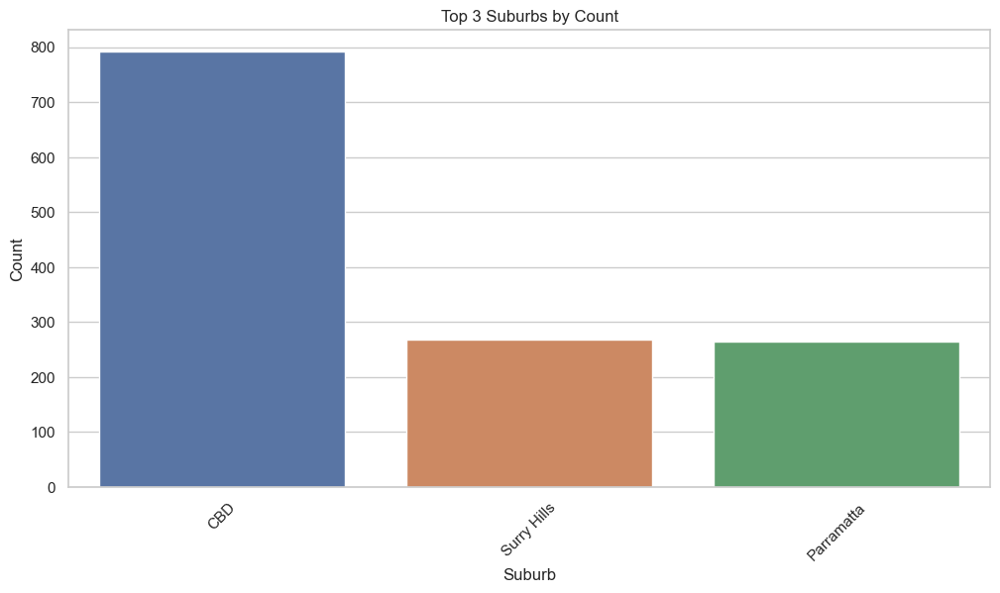

In [32]:
# Extract the last part of each subzone and store it in a new column
df['subzone'] = df['subzone'].str.split(',').str[-1].str.strip()

# Count the occurrences of each suburb
suburb_counts = df['subzone'].value_counts()

# Select the top 3 suburbs
top_3_suburbs = suburb_counts.head(3)

print(top_3_suburbs)

# creating a barplot of top 3 suburbs
sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))
sns.barplot(x=top_3_suburbs.index, y=top_3_suburbs.values)
plt.xlabel('Suburb')
plt.ylabel('Count')
plt.title('Top 3 Suburbs by Count')
plt.xticks(rotation=45)
    
plt.show()


Comment: The CBD, Surry Hills and Parramatta are the top 3 suburbs with the highest number of restaurants.

Average      4501
Good         1916
Very Good     506
Poor          209
Excellent      51
Name: rating_text, dtype: int64


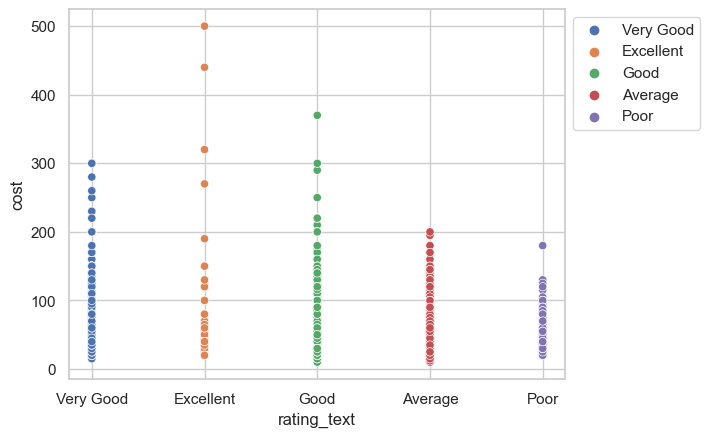

In [9]:
print(df.rating_text.value_counts())

# comparing rating text and cost
sns.scatterplot(x='rating_text', y='cost',hue='rating_text', data=df )
# Placing Legend outside the Figure
plt.legend(bbox_to_anchor=(1, 1), loc=2)

Comment: The scatter plot depicting the relationship between cost and rating text reveals interesting patterns in cost distribution. Notably, restaurants with an 'excellent' rating tend to have a wider range of cost categories, including some that are quite expensive. Conversely, restautrant with a 'Poor' rating are less likely to fall into the expensive cost category. However, it's worth mentioning that even among 'excellent' rated restaurants, there are instances with lower costs, demonstrating some variability in this relationship.

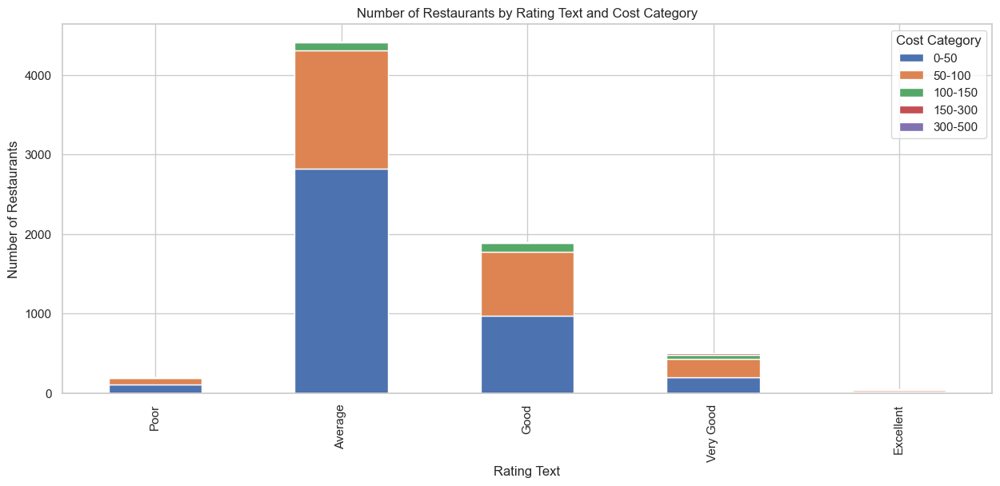

In [54]:
# Define cost categories
cost_bins = [0, 50, 100, 150,300,500]  # Adjust the bin edges as needed
cost_labels = ['0-50', '50-100', '100-150', '150-300', '300-500']

# Add a new column 'cost_category' based on 'cost'
df['cost_category'] = pd.cut(df['cost'], bins=cost_bins, labels=cost_labels)

# Define the desired order of 'rating_text'
rating_order = ['Poor', 'Average', 'Good', 'Very Good', 'Excellent']

# Convert 'rating_text' to a categorical variable with the desired order
df['rating_text'] = pd.Categorical(df['rating_text'], categories=rating_order, ordered=True)

# Group the data by 'rating_text' and 'cost_category' and count the occurrences
grouped_data = df.groupby(['rating_text', 'cost_category']).size().unstack().fillna(0)

# Create a stacked bar chart
ax = grouped_data.plot(kind='bar', stacked=True, figsize=(15, 6))

# Set plot labels and title
plt.xlabel('Rating Text')
plt.ylabel('Number of Restaurants')
plt.title('Number of Restaurants by Rating Text and Cost Category')

# Show the plot
plt.legend(title='Cost Category')
plt.show()


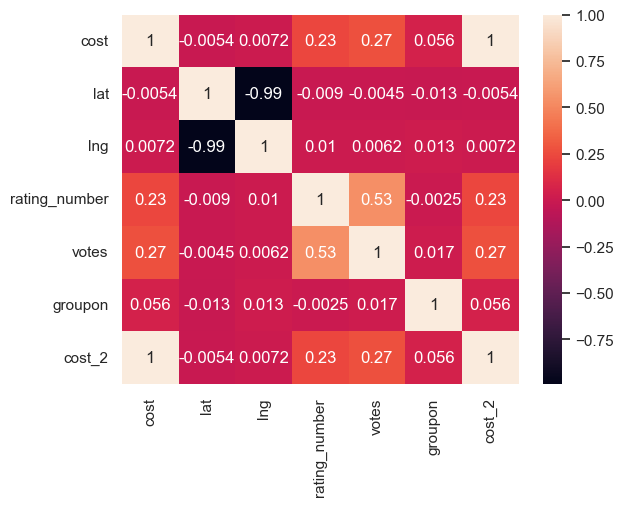

In [40]:
# Calculate the Pearson correlation matrix for numeric columns only
numeric_corr = df.corr(method='pearson', numeric_only=True)

# Create a heatmap with annotations
sns.heatmap(numeric_corr, annot=True)

# Show the plot
plt.show()

count    10153.000000
mean        51.153846
std         27.800787
min          8.000000
25%         30.000000
50%         45.000000
75%         60.000000
max        500.000000
Name: cost, dtype: float64


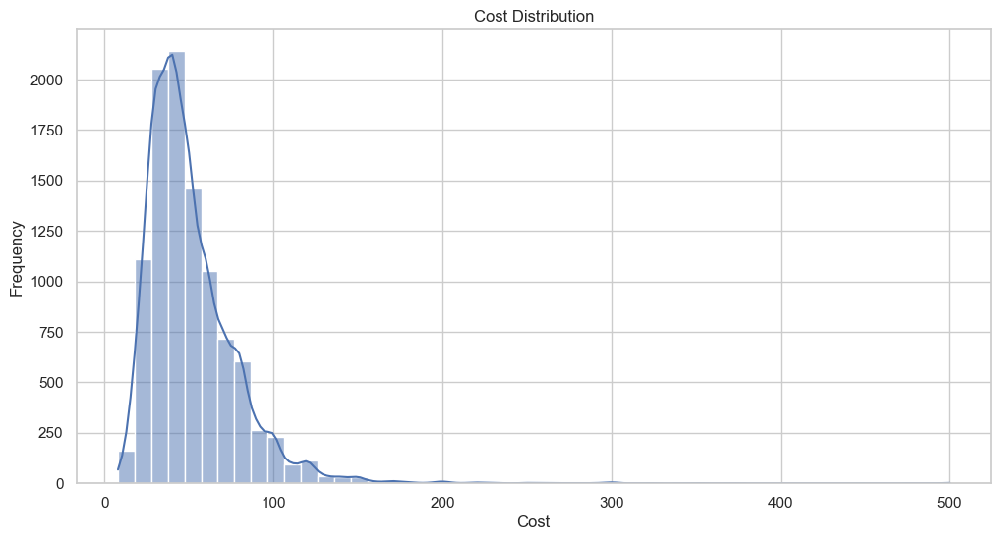

In [52]:
# Analysing cost variable

# using histogram to see the cost distribution
plt.figure(figsize=(12, 6))
sns.histplot(df['cost'], bins=50, kde=True)
plt.title('Cost Distribution')
plt.xlabel('Cost')
plt.ylabel('Frequency')

# Descriptive insights for 'Cost'
cost_description = df['cost'].describe()
print(cost_description)

Comment: The cost distribution indicates that the majority of restaurants have costs in the range of 30 to 60, with some outliers on both the lower and higher ends.

count    7183.000000
mean        3.283614
std         0.454585
min         1.800000
25%         3.000000
50%         3.300000
75%         3.600000
max         4.900000
Name: rating_number, dtype: float64


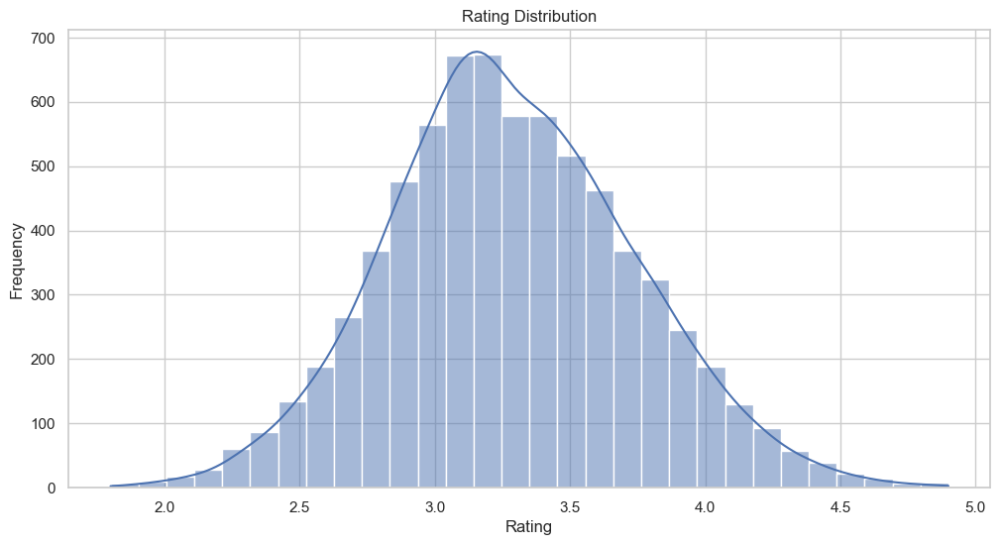

In [51]:
# using histogram to see the rating distribution

plt.figure(figsize=(12, 6))
sns.histplot(df['rating_number'], bins=30, kde=True)
plt.title('Rating Distribution')
plt.xlabel('Rating')
plt.ylabel('Frequency')

# Descriptive insights for 'Rating'
rating_description = df['rating_number'].describe()
print(rating_description)

Comment: The rating distribution indicates that the majority of ratings fall in the range of 3.0 to 3.6, with a mean rating of approximately 3.28.

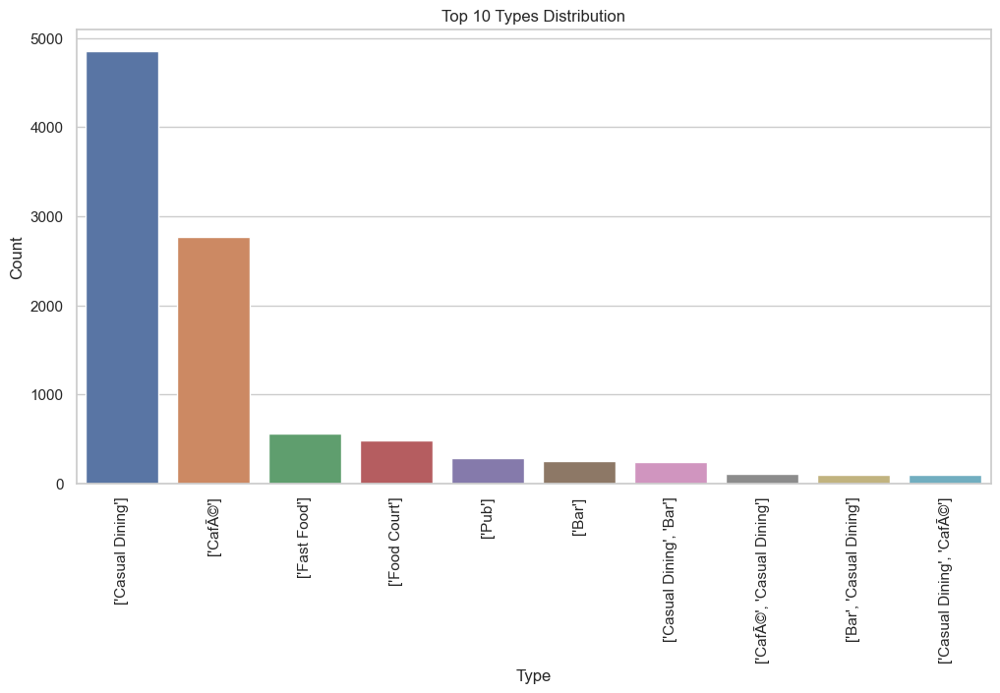

['Casual Dining']             4854
['CafÃ©']                     2767
['Fast Food']                  556
['Food Court']                 480
['Pub']                        284
['Bar']                        257
['Casual Dining', 'Bar']       237
['CafÃ©', 'Casual Dining']     110
['Bar', 'Casual Dining']       102
['Casual Dining', 'CafÃ©']     101
Name: type, dtype: int64


In [55]:
# Creating a bar chart to visualize the distribution of types

# top 10 types
top_10 = df['type'].value_counts().head(10)

# creating a barplot of top 10 types
sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))
sns.barplot(x=top_10.index, y=top_10.values)
plt.xlabel('Type')
plt.ylabel('Count')
plt.title('Top 10 Types Distribution')
plt.xticks(rotation=90)
    
plt.show()

# Descriptive insights for 'Type'
type_counts = df['type'].value_counts().head(10)
print(type_counts)

# 3. Cuisine Density Map

In [56]:
# load sydney geojson data
sydney_data = gpd.read_file("data/sydney.geojson")

In [57]:
# printing top 5 rows
sydney_data.head()

,SSC_CODE,SSC_NAME,CONF_VALUE,SQKM,geometry
0,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
1,10002,Abbotsford (NSW),Very good,1.017855,"POLYGON ((151.12593 -33.84578, 151.12678 -33.8..."
2,10010,Acacia Gardens,Very good,0.946630,"POLYGON ((150.90781 -33.73547, 150.90799 -33.7..."
3,10016,Airds,Very good,2.380773,"POLYGON ((150.84000 -34.07817, 150.84077 -34.0..."
4,10022,Alexandria,Very good,3.503330,"POLYGON ((151.18603 -33.91660, 151.18562 -33.9..."


<Axes: >

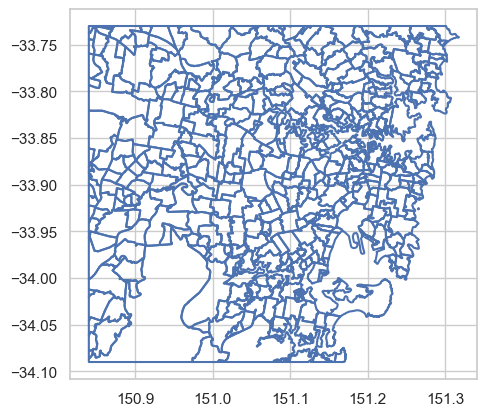

In [58]:
# plotting the geodata boundary
sydney_data.boundary.plot()

In [59]:
# cuisine density map function

def show_cuisine_densitymap(cuisine, colormap):
    
    # Filter restaurants by cuisine
    cuisine_data = df[df.cuisine.str.contains(cuisine)]

    # Convert the restaurant data to a GeoDataFrame
    cuisine_geo = gpd.GeoDataFrame(cuisine_data,geometry=gpd.points_from_xy(cuisine_data['lng'], cuisine_data['lat']))

    # Set the CRS of cuisine_geo to match that of sydney_geojson
    cuisine_geo.crs = sydney_data.crs

    # Perform a spatial join between the cuisine GeoDataFrame and the Sydney GeoDataFrame
    joined = gpd.sjoin(cuisine_geo, sydney_data, how='inner', predicate='within')


    # Group by suburb and count the number of restaurants serving the specified cuisine
    cuisine_density = joined.groupby('SSC_NAME').size().reset_index(name='Restaurant_Count')

    # Merge the cuisine density data with the Sydney GeoDataFrame
    global sydney_data_merged
    sydney_data_merged = sydney_data.merge(cuisine_density, on='SSC_NAME', how='left')
    
    # Plotting the Boundary 
    fig, ax = plt.subplots(1,1, figsize = (15, 10 ))
    sydney_data.boundary.plot(ax= ax, linewidth = 1, color = 'blue')

    # Plot the cuisine density map
    sydney_data_merged.plot(column = 'Restaurant_Count', cmap=colormap, linewidth=0.8, edgecolor='0.8', legend=True, ax = ax)

    plt.title(f'Cuisine Density Map for {cuisine} Restaurants in Sydney')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()
    
    

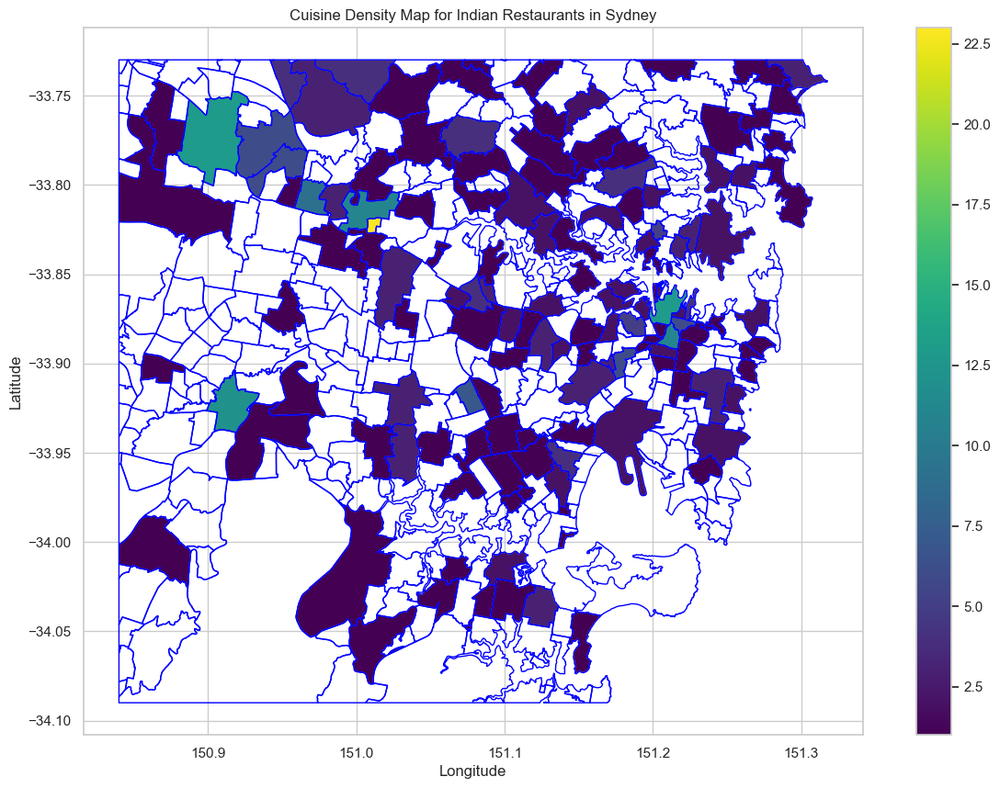

In [60]:
# Call the function to show the cuisine density map for a specific cuisine (e.g., 'Indian')
show_cuisine_densitymap(cuisine='Indian', colormap='viridis')

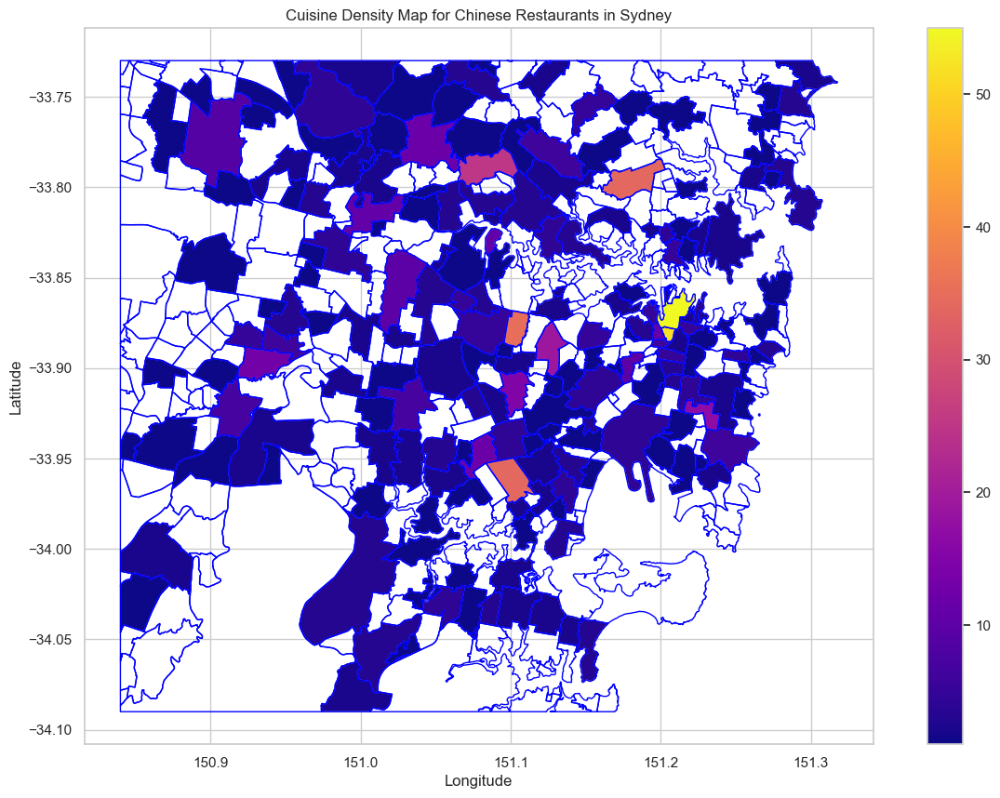

In [61]:
# Call the function to show the cuisine density map for a specific cuisine (e.g., 'Chinese')
show_cuisine_densitymap(cuisine='Chinese', colormap='plasma')

In [62]:
# Using Plotly library to create an interactive restaurant density map 

def show_interactive_cuisine_density_map(cuisine, colormap):
    
   
   # Create an interactive density map using Plotly Express
    fig = px.choropleth(sydney_data_merged,
                        geojson=sydney_data_merged.geometry,
                        locations=sydney_data_merged.index,
                        color='Restaurant_Count',
                        hover_name='SSC_NAME',
                        title=f'Cuisine Density Map for {cuisine} Restaurants in Sydney',
                        color_continuous_scale=colormap)

    fig.update_geos(fitbounds="locations", visible=False)
    fig.update_layout(autosize=False, width=800, height=600)
    

    fig.show()

In [63]:
show_interactive_cuisine_density_map(cuisine='Indian', colormap='plasma')

# Limitations of non-interactive plotting and how interactive libraries like Plotly can address them:

There are many limitations of non-interactive plotting such as:

It only offers a fixed view of the data and user cannot zoom in or explore specific data points in details.
Interactive libraries like Plotly allows users to Zoom in and out of the map, and explore more in details. This helps in geographical data as user may only want to focus on specific region.


In static plots, data filtering and highlighting are challenging to implement where as interactive libraries such as Ploty, allows user to select specific cuisine from a dropdown menu to instantly see the density of restaurants serving that cuisine. 

Static plots remain fixed once generated. If new data becomes available or if the data changes, the plot needs to be recreated from scratch where as Interactive libraries can update the plot in real-time as new data arrives. For instance, if new restaurant data is added or if restaurant ratings change, an interactive Plotly map can reflect these changes instantly. 

# Part B – Predictive Modelling

In [64]:
# import library

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, SGDRegressor, LogisticRegression
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.impute import SimpleImputer
import category_encoders as ce

# Feature Engineering

In [65]:
# assiging to a new data set for modelling
#df = pd.read_csv(csv_url)
df_model = df.copy()

In [66]:
# Dropping unnecessary columns
columns_to_drop = ['address', 'link', 'phone', 'color', 'cuisine_color', 'cost_2','cost_category']
df_model.drop(columns=columns_to_drop, inplace=True)

In [67]:
df_model.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10499 entries, 0 to 10499
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   cost           10153 non-null  float64 
 1   cuisine        10499 non-null  object  
 2   lat            10307 non-null  float64 
 3   lng            10307 non-null  float64 
 4   rating_number  7183 non-null   float64 
 5   rating_text    7183 non-null   category
 6   subzone        10499 non-null  object  
 7   title          10499 non-null  object  
 8   type           10451 non-null  object  
 9   votes          7183 non-null   float64 
 10  groupon        10499 non-null  bool    
dtypes: bool(1), category(1), float64(5), object(4)
memory usage: 840.9+ KB


In [68]:
# Types of Variables

# creating empty list
numeric_var = []
category_var = []

# appeding list type 
for col in df_model.columns:
    if df_model[col].dtype == 'float64':
        numeric_var.append(col)
    else:
        category_var.append(col)
        
display(numeric_var,category_var)
        

['cost', 'lat', 'lng', 'rating_number', 'votes']

['cuisine', 'rating_text', 'subzone', 'title', 'type', 'groupon']

# Exploring Categorical Variables

In [69]:
# Explore categorical variables
df_model[category_var].head()

,cuisine,rating_text,subzone,title,type,groupon
0,"['Hot Pot', 'Korean BBQ', 'BBQ', 'Korean']",Very Good,CBD,Sydney Madang,['Casual Dining'],False
1,"['Cafe', 'Coffee and Tea', 'Salad', 'PokÃ©']",Excellent,Alexandria,The Grounds of Alexandria Cafe,['CafÃ©'],False
2,['Japanese'],Excellent,Pyrmont,Sokyo,['Fine Dining'],False
3,['Modern Australian'],Excellent,Circular Quay,Bennelong Restaurant,"['Fine Dining', 'Bar']",False
4,"['Thai', 'Salad']",Excellent,Chinatown,Chat Thai,['Casual Dining'],False


In [70]:
# for categorical value
# number of unique labels

for var in category_var:
    unique_var_cat = df_model[var].unique()
    print(var, "has the", len(unique_var_cat), 'unique labels.')

cuisine has the 1759 unique labels.
rating_text has the 6 unique labels.
subzone has the 339 unique labels.
title has the 10407 unique labels.
type has the 67 unique labels.
groupon has the 2 unique labels.


In [71]:
# Handling Missing Values

# Identify categorical columns with missing values

null_counts_cat = df_model[category_var].isnull().sum()

cat_col_with_missing = null_counts_cat[null_counts_cat > 0].index.tolist()

print("Columns with null values: \n", df_model[cat_col_with_missing].isnull().sum())

print(" Percentage of null values: \n",100 * df_model[cat_col_with_missing].isnull().sum() / df_model.shape[0] )



Columns with null values: 
 rating_text    3316
type             48
dtype: int64
 Percentage of null values: 
 rating_text    31.583960
type            0.457186
dtype: float64


In [72]:
# Initialize an imputer for categorical columns
categorical_imputer = SimpleImputer(strategy='most_frequent')


# Impute missing values in categorical columns
for col in cat_col_with_missing:
        df_model[col] = categorical_imputer.fit_transform(df_model[[col]])
        
print(df_model[category_var].isnull().sum())

cuisine        0
rating_text    0
subzone        0
title          0
type           0
groupon        0
dtype: int64


In [73]:
df_model.head()

,cost,cuisine,lat,lng,rating_number,rating_text,subzone,title,type,votes,groupon
0,50.0,"['Hot Pot', 'Korean BBQ', 'BBQ', 'Korean']",-33.876059,151.207605,4.0,Very Good,CBD,Sydney Madang,['Casual Dining'],1311.0,False
1,80.0,"['Cafe', 'Coffee and Tea', 'Salad', 'PokÃ©']",-33.910999,151.193793,4.6,Excellent,Alexandria,The Grounds of Alexandria Cafe,['CafÃ©'],3236.0,False
2,120.0,['Japanese'],-33.867971,151.195210,4.9,Excellent,Pyrmont,Sokyo,['Fine Dining'],1227.0,False
3,270.0,['Modern Australian'],-33.856784,151.215297,4.9,Excellent,Circular Quay,Bennelong Restaurant,"['Fine Dining', 'Bar']",278.0,False
4,55.0,"['Thai', 'Salad']",-33.879035,151.206409,4.5,Excellent,Chinatown,Chat Thai,['Casual Dining'],2150.0,False


# Exploring Numerical Variables

In [74]:
# Explore Numerical variables
df_model[numeric_var].head()

,cost,lat,lng,rating_number,votes
0,50.0,-33.876059,151.207605,4.0,1311.0
1,80.0,-33.910999,151.193793,4.6,3236.0
2,120.0,-33.867971,151.195210,4.9,1227.0
3,270.0,-33.856784,151.215297,4.9,278.0
4,55.0,-33.879035,151.206409,4.5,2150.0


In [75]:
# for numeric value
# number of unique labels

for var in numeric_var:
    unique_var_numeric = df_model[var].unique()
    print(var, "has the", len(unique_var_numeric), 'unique labels.')

cost has the 84 unique labels.
lat has the 8031 unique labels.
lng has the 7993 unique labels.
rating_number has the 33 unique labels.
votes has the 548 unique labels.


In [76]:
# Handling Missing Values

# Identify categorical columns with missing values

null_counts_num = df_model[numeric_var].isnull().sum()

num_col_with_missing = null_counts_num[null_counts_num > 0].index.tolist()

print("Columns with null values: \n", df_model[num_col_with_missing].isnull().sum())

print(" Percentage of null values: \n",100 * df_model[num_col_with_missing].isnull().sum() / df_model.shape[0] )



Columns with null values: 
 cost              346
lat               192
lng               192
rating_number    3316
votes            3316
dtype: int64
 Percentage of null values: 
 cost              3.295552
lat               1.828746
lng               1.828746
rating_number    31.583960
votes            31.583960
dtype: float64


In [77]:
# summary statistics in numerical variables
print(round(df_model[numeric_var].describe()), 2)

          cost      lat      lng  rating_number   votes
count  10153.0  10307.0  10307.0         7183.0  7183.0
mean      51.0    -33.0    148.0            3.0    84.0
std       28.0      8.0     27.0            0.0   175.0
min        8.0    -38.0   -123.0            2.0     4.0
25%       30.0    -34.0    151.0            3.0    12.0
50%       45.0    -34.0    151.0            3.0    32.0
75%       60.0    -34.0    151.0            4.0    87.0
max      500.0     52.0    153.0            5.0  3236.0 2


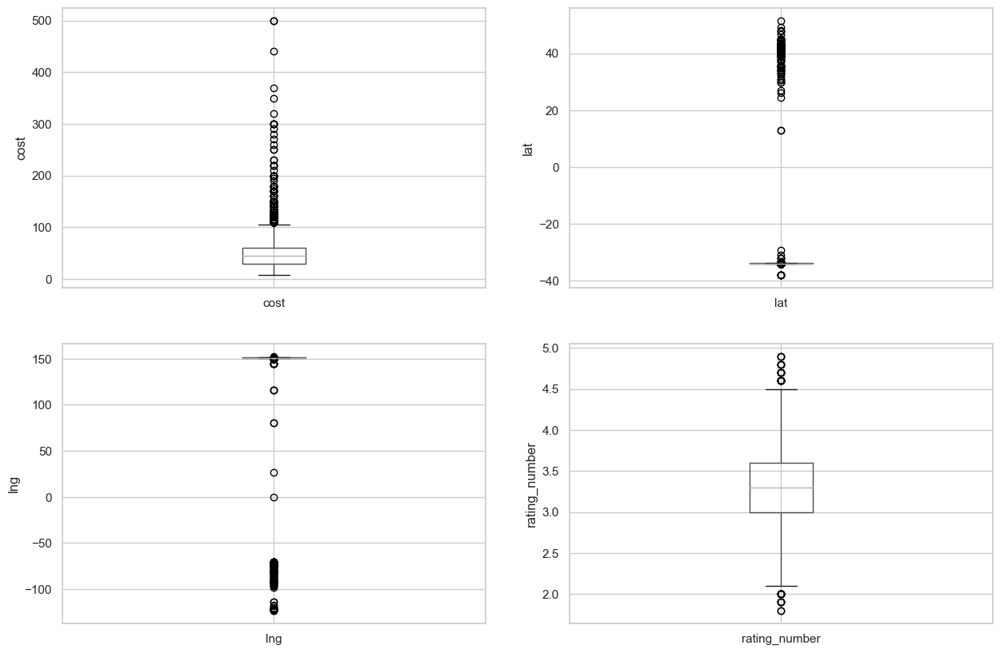

In [78]:
# Visualizing outliers in numeric variables

plt.figure(figsize=(15, 10))

for col in numeric_var:
    
    subplot_num = numeric_var.index(col) + 1
    
    plt.subplot(2,2,subplot_num)
    fig = df_model.boxplot(column= col)
    fig.set_title('')
    fig.set_ylabel(col)

    if(subplot_num == 4 ):
        break

        

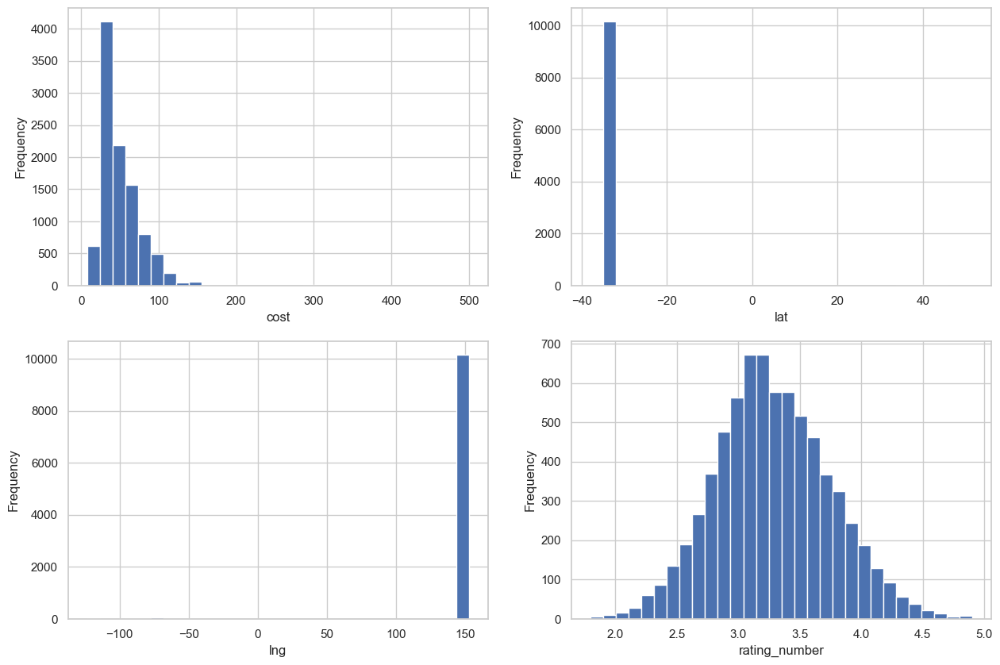

In [79]:
# Visualizing distribution in numeric variables


plt.figure(figsize=(15, 10))

for col in numeric_var:
    
    subplot_num = numeric_var.index(col) + 1
    
    plt.subplot(2,2,subplot_num)
    fig = df_model[col].hist(bins = 30)
    fig.set_title('')
    fig.set_xlabel(col)
    fig.set_ylabel("Frequency")

    if(subplot_num == 4 ):
        break



In [80]:
# Finding Outliers in Numerical Variables

def outliers_func(var, factor= 3, print_summary=True):
    IQR = df_model[var].quantile(0.75) - df_model[var].quantile(0.25)
    Lower_boundary = df_model[var].quantile(0.25) - (IQR * factor)
    Upper_boundary = df_model[var].quantile(0.75) + (IQR * factor)
    
    outliers= []
    for i, val in enumerate(df_model[var]):
        if val < Lower_boundary or val > Upper_boundary:
            outliers.append(i)
    
    
    if(print_summary):
        print('{var} outliers are values < {lowerboundary} or > {upperboundary}'.format(var= var, lowerboundary=Lower_boundary, upperboundary=Upper_boundary))
    return Lower_boundary, Upper_boundary, outliers


In [81]:
print(outliers_func('cost'))
print(outliers_func('lat'))
print(outliers_func('lng'))
print(outliers_func('rating_number'))

cost outliers are values < -60.0 or > 150.0
(-60.0, 150.0, [3, 10, 14, 19, 37, 40, 44, 53, 55, 61, 98, 100, 107, 138, 154, 173, 185, 199, 205, 229, 257, 267, 274, 282, 293, 302, 310, 313, 323, 325, 334, 354, 359, 370, 371, 414, 432, 452, 485, 531, 586, 618, 695, 977, 986, 993, 1146, 1630, 2209, 2624, 3610, 3773, 5172, 6702, 7015, 8159, 8603, 9797, 10124, 10321])
lat outliers are values < -34.1560141 or > -33.5565369
(-34.1560141, -33.5565369, [42, 234, 269, 280, 307, 387, 422, 423, 444, 507, 613, 763, 810, 824, 851, 873, 896, 898, 929, 1071, 1139, 1223, 1236, 1253, 1267, 1318, 1445, 1481, 1586, 1616, 1652, 1753, 1756, 1848, 2064, 2080, 2122, 2202, 2227, 2253, 2278, 2341, 2393, 2440, 2494, 2541, 2544, 2565, 2596, 2616, 2637, 2644, 2699, 3006, 3030, 3039, 3119, 3172, 3184, 3204, 3215, 3346, 3372, 3425, 3591, 3614, 3891, 3952, 3985, 4010, 4056, 4068, 4245, 4324, 4348, 4502, 4517, 4525, 4546, 4631, 4636, 4638, 4661, 4664, 4750, 4792, 4810, 4932, 5021, 5028, 5075, 5122, 5336, 5406, 5419, 54

In [82]:
# Initialize an imputer for numerical columns
numerical_imputer = SimpleImputer(strategy='median')

# Impute missing values in numerical columns
for col in num_col_with_missing:
    df_model[col] = numerical_imputer.fit_transform(df_model[[col]])

print(df_model[numeric_var].isnull().sum())

cost             0
lat              0
lng              0
rating_number    0
votes            0
dtype: int64


# Regression Models

In [84]:
# creating copy of df_model
df_LR = df_model.copy()

In [85]:
# Label encoding for categorical features
label_encoders = {}
for column in category_var:
    le = LabelEncoder()
    df_LR[column] = le.fit_transform(df_LR[column])
    label_encoders[column] = le

In [86]:
# Split data into train and test sets (80% train, 20% test)
X_regression = df_LR.drop(columns=['rating_number'], axis = 1)
y_regression = df_LR['rating_number']

X_train, X_test, y_train, y_test = train_test_split(X_regression, y_regression, test_size=0.2, random_state=0)

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(8399, 10) (8399,)
(2100, 10) (2100,)


In [87]:
# Feature Scaling or Standarlization

cols = X_train.columns

scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

# getting the data frame 
X_train = pd.DataFrame(X_train, columns = [cols])
X_test = pd.DataFrame(X_test, columns = [cols])

X_train.head()

,cost,cuisine,lat,lng,rating_text,subzone,title,type,votes,groupon
0,0.065041,0.374858,0.043388,0.993941,0.0,0.118343,0.116760,0.523077,0.008663,0.0
1,0.065041,0.320819,0.043899,0.993860,0.0,0.304734,0.616663,0.369231,0.000309,0.0
2,0.014228,0.125142,0.044370,0.993705,0.0,0.000000,0.254372,0.076923,0.013304,0.0
3,0.136179,0.381684,0.044144,0.993972,0.0,0.204142,0.409475,0.523077,0.005879,0.0
4,0.075203,0.251991,0.042157,0.992401,0.0,0.150888,0.033827,0.415385,0.004022,0.0


# Model 1: Linear Regression

In [88]:
# Create a Linear model and train it
LR = LinearRegression()
LR.fit(X_train, y_train)

LinearRegression()

In [89]:
# Use model to predict the TRAIN and TEST Data
y_prediction_train = LR.predict(X_train)
y_prediction_test = LR.predict(X_test)

# calculating Mean Squared Error of test data
LR_mse = mean_squared_error(y_test, y_prediction_test)
print("Mean Squared Error (MSE) for Linear Regression:", LR_mse)

# Score the model
LR_r2_score = r2_score(y_train, y_prediction_train)
print("R^2 Score for Linear Regression:", LR_r2_score)

Mean Squared Error (MSE) for Linear Regression: 0.0742702319250323
R^2 Score for Linear Regression: 0.3958940374028588


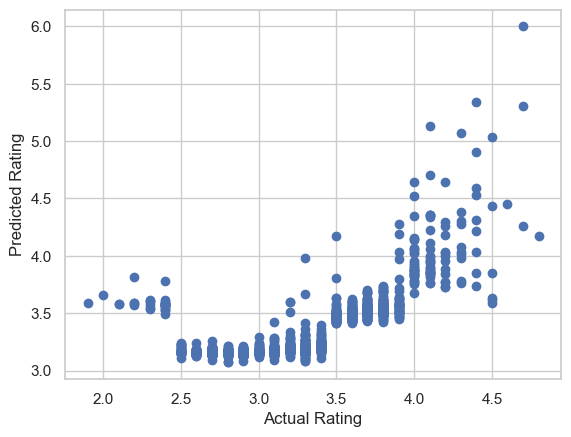

In [90]:
# plotting the test data 
plt.scatter(y_test, y_prediction_test)
plt.xlabel("Actual Rating")
plt.ylabel("Predicted Rating")
plt.show()

In [91]:
# Create a Linear model with Gradient Descent and train it
SGD = SGDRegressor()
SGD.fit(X_train, y_train)

SGDRegressor()

In [93]:
# Use model to predict the TRAIN and TEST Data using SGD
y_prediction_train_sgd = SGD.predict(X_train)
y_prediction_test_sgd = SGD.predict(X_test)

In [94]:
# calculating Mean Squared Error of test data for SGD Linear Regression
SGD_mse = mean_squared_error(y_test, y_prediction_test_sgd)
print("Mean Squared Error (MSE) for Linear Regression with SGD:", SGD_mse)

# Score the SGD Linear Regression model
SGD_r2_score = r2_score(y_train, y_prediction_train_sgd)
print("R^2 Score for Linear Regression with SGD:", SGD_r2_score)

Mean Squared Error (MSE) for Linear Regression with SGD: 0.08458871498760785
R^2 Score for Linear Regression with SGD: 0.3071277100351658


# Comment :
MSE Comparison:

LR Model 1 (Linear Regression): MSE = 0.0727
LR with SGD (Linear Regression with Stochastic Gradient Descent): MSE = 0.0841

The lower the MSE, the better the models predictive performance. In this case, LR Model 1 has a lower MSE, indicating that it makes more accurate predictions on average compared to LR with SGD. Thus, LR Model 1 is better in terms of MSE.

R-squared (R^2) Score Comparison:

LR Model 1 (Linear Regression): R^2 Score = 0.4007
LR with SGD (Linear Regression with Stochastic Gradient Descent): R^2 Score = 0.3145

The R^2 score measures how well the model explains the variance in the data. A higher R^2 score indicates a better fit. LR Model 1 has a higher R^2 score, indicating that it explains more of the variance in the restaurant ratings compared to LR with SGD. Thus, LR Model 1 is better in terms of R^2 score.

# Classification

In [122]:
# Simplify the problem into binary classifications

# copy data frame for classification

df_class = df_model.copy()

# Create a new column for binary classification
# Class 1: 'Poor' and 'Average'
# Class 2: 'Good', 'Very Good', and 'Excellent'
df_class['class'] = df_class['rating_text'].map({'Poor': 1, 'Average': 1, 'Good': 2, 'Very Good': 2, 'Excellent': 2})


In [124]:
df_class.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10499 entries, 0 to 10499
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   cost           10499 non-null  float64
 1   cuisine        10499 non-null  object 
 2   lat            10499 non-null  float64
 3   lng            10499 non-null  float64
 4   rating_number  10499 non-null  float64
 5   rating_text    10499 non-null  object 
 6   subzone        10499 non-null  object 
 7   title          10499 non-null  object 
 8   type           10499 non-null  object 
 9   votes          10499 non-null  float64
 10  groupon        10499 non-null  bool   
 11  class          10499 non-null  int64  
dtypes: bool(1), float64(5), int64(1), object(5)
memory usage: 994.5+ KB


In [125]:
# Create a BinaryEncoder instance for groupon
encoder = ce.BinaryEncoder(cols=['groupon'])

# Fit and transform the "groupon" column 
df_class = encoder.fit_transform(df_class)


In [126]:
# display categorical variables
categorical_var = [var for var in df_class.columns if df_class[var].dtypes == 'O']
print(categorical_var)

# display numerical variables
numericals_var = [var for var in df_class.columns if df_class[var].dtypes != 'O']
print(numericals_var)

['cuisine', 'rating_text', 'subzone', 'title', 'type']
['cost', 'lat', 'lng', 'rating_number', 'votes', 'groupon_0', 'groupon_1', 'class']


In [127]:
# Label encoding for categorical features
label_encoders = {}
for column in categorical_var:
    le = LabelEncoder()
    df_class[column] = le.fit_transform(df_class[column])
    label_encoders[column] = le

In [128]:
df_class.head()

,cost,cuisine,lat,lng,rating_number,rating_text,subzone,title,type,votes,groupon_0,groupon_1,class
0,50.0,978,-33.876059,151.207605,4.0,4,48,8425,34,1311.0,0,1,2
1,80.0,467,-33.910999,151.193793,4.6,1,1,9082,24,3236.0,0,1,2
2,120.0,1159,-33.867971,151.195210,4.9,1,245,7904,51,1227.0,0,1,2
3,270.0,1412,-33.856784,151.215297,4.9,1,72,892,49,278.0,0,1,2
4,55.0,1696,-33.879035,151.206409,4.5,1,69,1895,34,2150.0,0,1,2


In [129]:
#Split the data into training and testing sets

# Features
X = df_class.drop(['class', 'rating_text'], axis=1) 
# Target variable
y = df_class['class']  


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(8399, 11) (8399,)
(2100, 11) (2100,)


In [130]:
# display missing values
print(X_train.isnull().sum())
print(X_test.isnull().sum())

cost             0
cuisine          0
lat              0
lng              0
rating_number    0
subzone          0
title            0
type             0
votes            0
groupon_0        0
groupon_1        0
dtype: int64
cost             0
cuisine          0
lat              0
lng              0
rating_number    0
subzone          0
title            0
type             0
votes            0
groupon_0        0
groupon_1        0
dtype: int64


In [103]:
X_train.head()

,cost,cuisine,lat,lng,rating_number,subzone,title,type,votes,groupon_0,groupon_1
7815,40.0,659,-33.944259,151.195930,3.3,40,1215,34,32.0,0,1
7398,40.0,564,-33.898579,151.173680,2.8,103,6417,24,5.0,0,1
3943,15.0,220,-33.856568,151.130704,3.4,0,2647,5,47.0,0,1
2294,75.0,671,-33.876754,151.204359,3.2,69,4261,34,23.0,0,1
6862,45.0,443,-34.054233,150.770691,3.0,51,352,27,17.0,0,1


In [104]:
# Instantiate the Logistic Regression model
logistic_reg_model = LogisticRegression(solver='liblinear', random_state=0)

# Fit the model to the training data
logistic_reg_model.fit(X_train, y_train)

LogisticRegression(random_state=0, solver='liblinear')

In [105]:
# Make predictions on the test data
y_pred_test = logistic_reg_model.predict(X_test)

# Display the predicted values
print(y_pred_test)


[1 1 1 ... 2 1 1]


In [106]:
# Calculate and print the accuracy score
accuracy_lr = accuracy_score(y_test, y_pred_test)
print(f'Model accuracy score: {accuracy_lr:.4f}')


Model accuracy score: 0.9205


In [107]:
# Calculate the confusion matrix
confusion_lr = confusion_matrix(y_test, y_pred_test)

# Display the confusion matrix
print("Confusion Matrix:")
print(confusion_lr)

# Calculate and display True Positives (TP)
print('\nTrue Positives(TP) = ', confusion_lr[0, 0])

# Calculate and display True Negatives (TN)
print('\nTrue Negatives(TN) = ', confusion_lr[1, 1])

# Calculate and display False Positives (FP)
print('\nFalse Positives(FP) = ', confusion_lr[0, 1])

# Calculate and display False Negatives (FN)
print('\nFalse Negatives(FN) = ', confusion_lr[1, 0])

Confusion Matrix:
[[1569   34]
 [ 133  364]]

True Positives(TP) =  1569

True Negatives(TN) =  364

False Positives(FP) =  34

False Negatives(FN) =  133


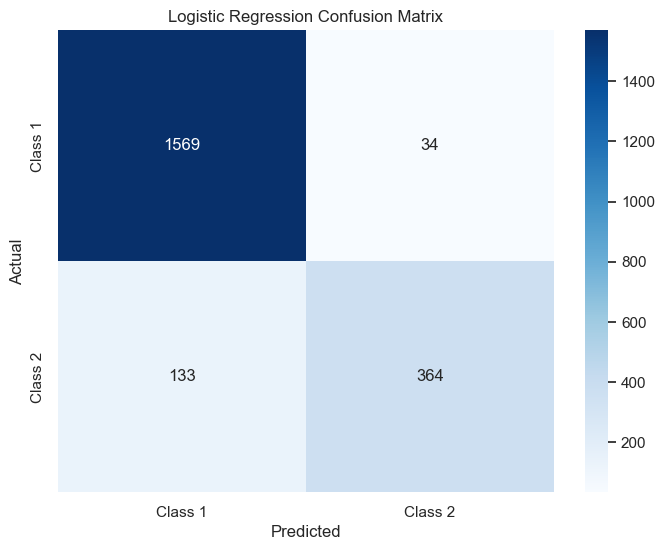

In [108]:
# Create a Seaborn heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_lr, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Class 1', 'Class 2'], 
            yticklabels=['Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Logistic Regression Confusion Matrix')
plt.show()

# Performance evaluation of logistic regression model:

Accuracy: The model achieved an accuracy score of approximately 0.9205, which is quite good. It means that about 92% of the records were classified correctly.


# Observation:

The model is relatively good at classifying records as Class 1 ('Poor' and 'Average'). It has a high True Positive rate (1569 TP) for Class 1.

The model also performs reasonably well in Class 2 ('Good', 'Very Good', and 'Excellent'), with a high True Negative rate (364 TN).

There are some false positives (34 FP) and false negatives (133 FN), indicating that the model makes some errors in classifying records.

The choice of features and the logistic regression model seem to be effective in distinguishing between 'Poor'/'Average' and 'Good'/'Very Good'/'Excellent' records.

Overall, the model is quite good at distinguishing between the two classes, but there is room for improvement, especially in reducing false positives and false negatives.

# Using other model for evaluation

In [109]:
# Using Random Forest Classifier

from sklearn.ensemble import RandomForestClassifier

# Instantiate the Random Forest Classifier model
rf_model = RandomForestClassifier(random_state=0)

# Fit the model to the training data
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

In [110]:
# Make predictions on the test data
y_pred_rf = rf_model.predict(X_test)

# Calculate and print the accuracy score
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f'Random Forest Model accuracy score: {accuracy_rf:.4f}')

Random Forest Model accuracy score: 1.0000


In [111]:
# Calculate the confusion matrix for Random Forest
confusion_rf = confusion_matrix(y_test, y_pred_rf)

# Display the confusion matrix for Random Forest
print("Confusion Matrix for Random Forest:")
print(confusion_rf)

# Calculate and display True Positives (TP)
print('\nTrue Positives(TP) = ', confusion_rf[0, 0])

# Calculate and display True Negatives (TN)
print('\nTrue Negatives(TN) = ', confusion_rf[1, 1])

# Calculate and display False Positives (FP)
print('\nFalse Positives(FP) = ', confusion_rf[0, 1])

# Calculate and display False Negatives (FN)
print('\nFalse Negatives(FN) = ', confusion_rf[1, 0])

Confusion Matrix for Random Forest:
[[1603    0]
 [   0  497]]

True Positives(TP) =  1603

True Negatives(TN) =  497

False Positives(FP) =  0

False Negatives(FN) =  0


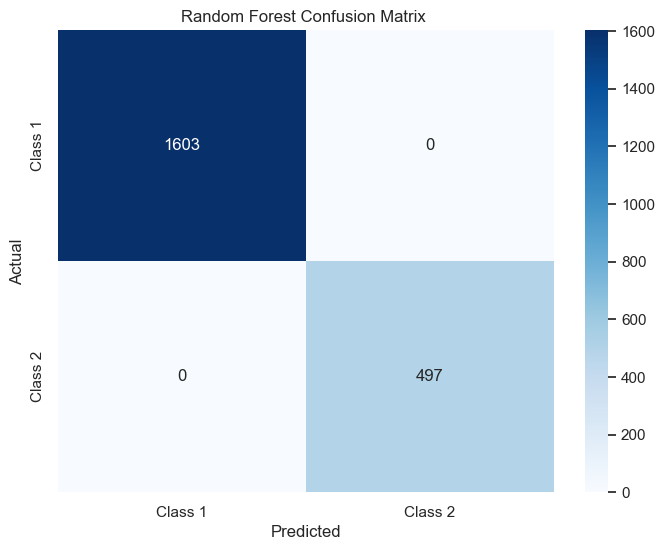

In [112]:
# Create a Seaborn heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_rf, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Class 1', 'Class 2'], 
            yticklabels=['Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Random Forest Confusion Matrix ')
plt.show()

Comments:

In [113]:
# using Decision Tree Classifier

from sklearn.tree import DecisionTreeClassifier

# Instantiate the Decision Tree Classifier model
dt_model = DecisionTreeClassifier(random_state=0)

# Fit the model to the training data
dt_model.fit(X_train, y_train)


DecisionTreeClassifier(random_state=0)

In [115]:
# Make predictions on the test data
y_pred_dt = dt_model.predict(X_test)

# Calculate and print the accuracy score for Decision Tree Classifier
accuracy_dt = accuracy_score(y_test, y_pred_dt)
print(f'Decision Tree Model accuracy score: {accuracy_dt:.4f}')

Decision Tree Model accuracy score: 1.0000


In [116]:
# Calculate the confusion matrix for Decision Tree Classifier
confusion_dt = confusion_matrix(y_test, y_pred_dt)

# Display the confusion matrix for Decision Tree Classifier
print("Confusion Matrix for Decision Tree Classifier:")
print(confusion_dt)


# Calculate and display True Positives (TP)
print('\nTrue Positives(TP) = ', confusion_dt[0, 0])

# Calculate and display True Negatives (TN)
print('\nTrue Negatives(TN) = ', confusion_dt[1, 1])

# Calculate and display False Positives (FP)
print('\nFalse Positives(FP) = ', confusion_dt[0, 1])

# Calculate and display False Negatives (FN)
print('\nFalse Negatives(FN) = ', confusion_dt[1, 0])

Confusion Matrix for Decision Tree Classifier:
[[1603    0]
 [   0  497]]

True Positives(TP) =  1603

True Negatives(TN) =  497

False Positives(FP) =  0

False Negatives(FN) =  0


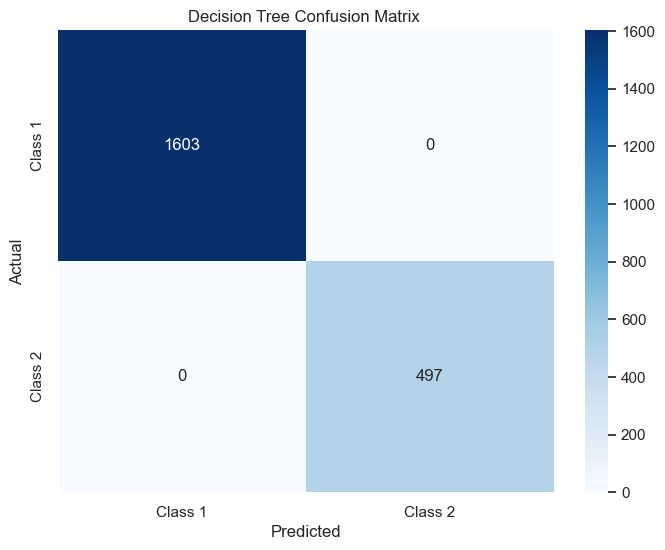

In [133]:
# Create a Seaborn heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_dt, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Class 1', 'Class 2'], 
            yticklabels=['Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Decision Tree Confusion Matrix ')
plt.show()

In [118]:
# using K-Neighbors Classifiers

from sklearn.neighbors import KNeighborsClassifier


# Instantiate the K-Neighbors Classifier model
knn_model = KNeighborsClassifier()

# Fit the model to the training data
knn_model.fit(X_train, y_train)


KNeighborsClassifier()

In [119]:
# Make predictions on the test data
y_pred_knn = knn_model.predict(X_test)

# Calculate and print the accuracy score for K-Neighbors Classifier
accuracy_knn = accuracy_score(y_test, y_pred_knn)
print(f'K-Neighbors Model accuracy score: {accuracy_knn:.4f}')

K-Neighbors Model accuracy score: 0.8314


In [120]:
# Calculate the confusion matrix for K-Neighbors Classifier
confusion_knn = confusion_matrix(y_test, y_pred_knn)

# Display the confusion matrix for K-Neighbors Classifier
print("Confusion Matrix for K-Neighbors Classifier:")
print(confusion_knn)

# Calculate and display True Positives (TP)
print('\nTrue Positives(TP) = ', confusion_knn[0, 0])

# Calculate and display True Negatives (TN)
print('\nTrue Negatives(TN) = ', confusion_knn[1, 1])

# Calculate and display False Positives (FP)
print('\nFalse Positives(FP) = ', confusion_knn[0, 1])

# Calculate and display False Negatives (FN)
print('\nFalse Negatives(FN) = ', confusion_knn[1, 0])

Confusion Matrix for K-Neighbors Classifier:
[[1554   49]
 [ 305  192]]

True Positives(TP) =  1554

True Negatives(TN) =  192

False Positives(FP) =  49

False Negatives(FN) =  305


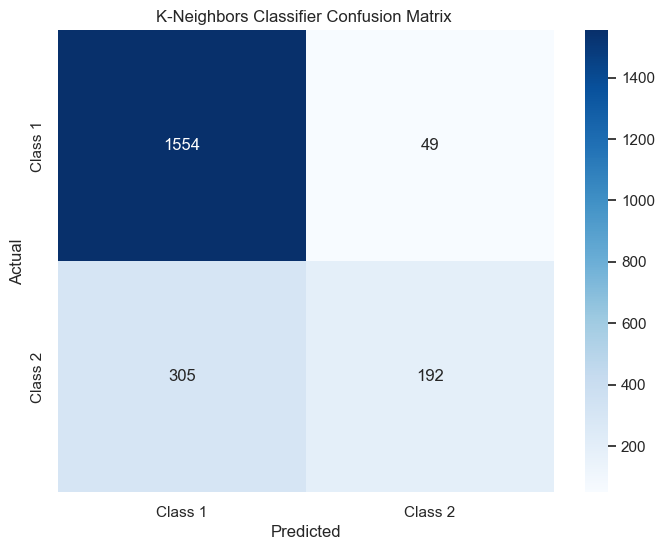

In [121]:
# Create a Seaborn heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_knn, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Class 1', 'Class 2'], 
            yticklabels=['Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('K-Neighbors Classifier Confusion Matrix ')
plt.show()

# Performance report for the confusion matrices

Both the Random Forest Classifier and the Decision Tree Classifier achieved perfect accuracy on the test data, with no misclassifications (0 false positives and 0 false negatives). This suggests that these models fit the training data very well, possibly overfitting it.

Logistic Regression also performed quite well with an accuracy score of 0.9205. It had a moderate number of false positives and false negatives compared to the perfect scores of the tree-based models.

K-Neighbors Classifier had the lowest accuracy score of 0.8314 and a higher number of false positives and false negatives compared to the other models, indicating that it might not fit the data as well as the tree-based models.